# Regression in action

Обработка случайного датасета с Kaggle. 

Под руку попался датасет с прогулами на работе - https://www.kaggle.com/loganalive/absenteeism-at-work-an-uci-dataset - его и препарирую.

Для начала сделаю самое простое бейзлайн-решение. 

## Simple baseline-decision

In [1]:
import numpy as np
import pandas as pd
import pandas_profiling 

import matplotlib.pyplot as plt
import seaborn as sns

plt.style.use('seaborn-colorblind')
%matplotlib inline
plt.rcParams["figure.figsize"] = [14, 10]

%config Completer.use_jedi = False

print("Imports Done!")

Imports Done!


In [2]:
PATH = "~/PycharmProjects/Datasets/"

In [3]:
dataset_origin = pd.read_csv(PATH + "Absenteeism_at_work.csv")
dataset_origin.head()

,ID,Reason for absence,Month of absence,Day of the week,Seasons,Transportation expense,Distance from Residence to Work,Service time,Age,Work load Average/day,...,Disciplinary failure,Education,Son,Social drinker,Social smoker,Pet,Weight,Height,Body mass index,Absenteeism time in hours
0,11,26,7,3,1,289,36,13,33,239.554,...,0,1,2,1,0,1,90,172,30,4
1,36,0,7,3,1,118,13,18,50,239.554,...,1,1,1,1,0,0,98,178,31,0
2,3,23,7,4,1,179,51,18,38,239.554,...,0,1,0,1,0,0,89,170,31,2
3,7,7,7,5,1,279,5,14,39,239.554,...,0,1,2,1,1,0,68,168,24,4
4,11,23,7,5,1,289,36,13,33,239.554,...,0,1,2,1,0,1,90,172,30,2


In [4]:
dataset_origin.describe()

,ID,Reason for absence,Month of absence,Day of the week,Seasons,Transportation expense,Distance from Residence to Work,Service time,Age,Work load Average/day,...,Disciplinary failure,Education,Son,Social drinker,Social smoker,Pet,Weight,Height,Body mass index,Absenteeism time in hours
count,740.000000,740.000000,740.000000,740.000000,740.000000,740.000000,740.000000,740.000000,740.000000,740.000000,...,740.000000,740.000000,740.000000,740.000000,740.000000,740.000000,740.000000,740.000000,740.000000,740.000000
mean,18.017568,19.216216,6.324324,3.914865,2.544595,221.329730,29.631081,12.554054,36.450000,271.490235,...,0.054054,1.291892,1.018919,0.567568,0.072973,0.745946,79.035135,172.114865,26.677027,6.924324
std,11.021247,8.433406,3.436287,1.421675,1.111831,66.952223,14.836788,4.384873,6.478772,39.058116,...,0.226277,0.673238,1.098489,0.495749,0.260268,1.318258,12.883211,6.034995,4.285452,13.330998
min,1.000000,0.000000,0.000000,2.000000,1.000000,118.000000,5.000000,1.000000,27.000000,205.917000,...,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,56.000000,163.000000,19.000000,0.000000
25%,9.000000,13.000000,3.000000,3.000000,2.000000,179.000000,16.000000,9.000000,31.000000,244.387000,...,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,69.000000,169.000000,24.000000,2.000000
50%,18.000000,23.000000,6.000000,4.000000,3.000000,225.000000,26.000000,13.000000,37.000000,264.249000,...,0.000000,1.000000,1.000000,1.000000,0.000000,0.000000,83.000000,170.000000,25.000000,3.000000
75%,28.000000,26.000000,9.000000,5.000000,4.000000,260.000000,50.000000,16.000000,40.000000,294.217000,...,0.000000,1.000000,2.000000,1.000000,0.000000,1.000000,89.000000,172.000000,31.000000,8.000000
max,36.000000,28.000000,12.000000,6.000000,4.000000,388.000000,52.000000,29.000000,58.000000,378.884000,...,1.000000,4.000000,4.000000,1.000000,1.000000,8.000000,108.000000,196.000000,38.000000,120.000000


In [5]:
dataset_origin.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 740 entries, 0 to 739
Data columns (total 21 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   ID                               740 non-null    int64  
 1   Reason for absence               740 non-null    int64  
 2   Month of absence                 740 non-null    int64  
 3   Day of the week                  740 non-null    int64  
 4   Seasons                          740 non-null    int64  
 5   Transportation expense           740 non-null    int64  
 6   Distance from Residence to Work  740 non-null    int64  
 7   Service time                     740 non-null    int64  
 8   Age                              740 non-null    int64  
 9   Work load Average/day            740 non-null    float64
 10  Hit target                       740 non-null    int64  
 11  Disciplinary failure             740 non-null    int64  
 12  Education             

### Базовый отчёт по данным

Так как переменных не так много, то можно построить отчёт с помощью pandas_profiling, он не будет слишком перегруженным.

In [6]:
pandas_profiling.ProfileReport(dataset_origin)

Summarize dataset:   0%|          | 0/34 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Итак, в результате видно, что есть примерно 5 % повторяющихся строк, высокая корреляция между индексом массы тела и весом.

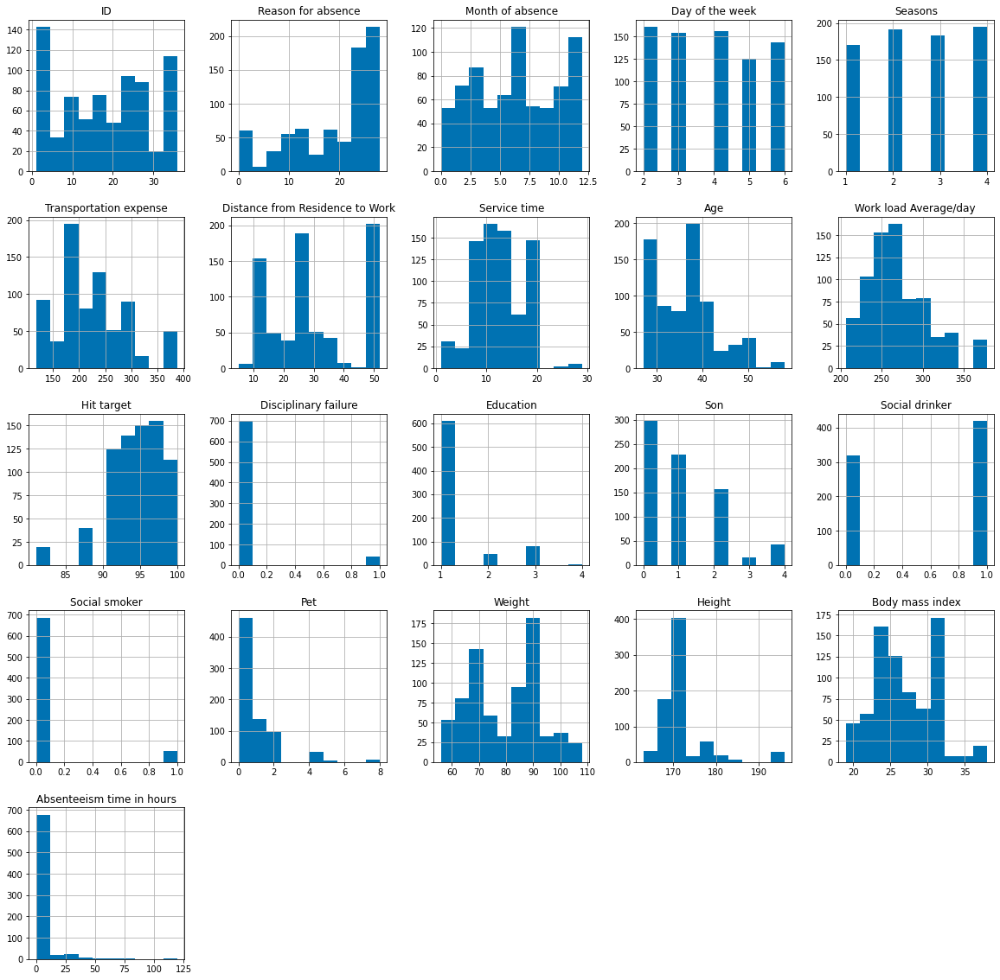

In [7]:
dataset_origin.hist(figsize=(20,20));

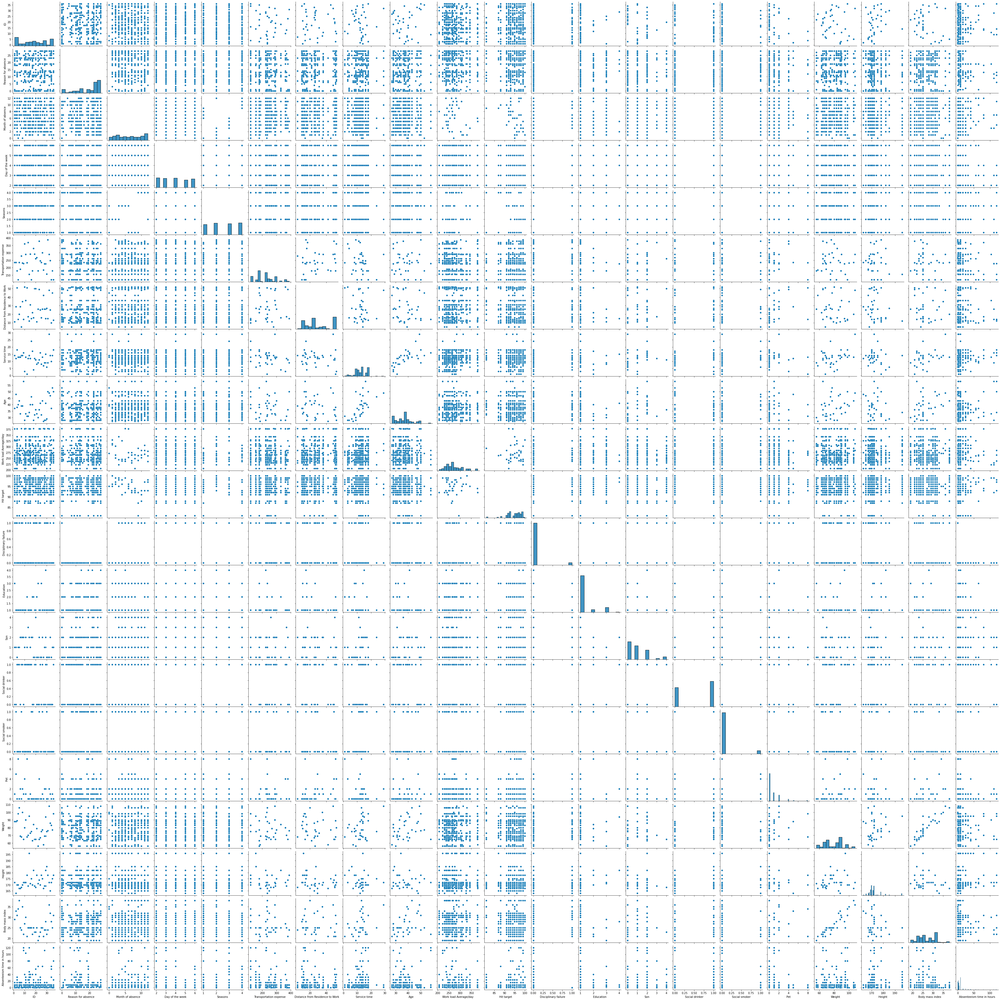

In [8]:
sns.pairplot(dataset_origin)

In [9]:
dataset_origin.columns

Index(['ID', 'Reason for absence', 'Month of absence', 'Day of the week',
       'Seasons', 'Transportation expense', 'Distance from Residence to Work',
       'Service time', 'Age', 'Work load Average/day ', 'Hit target',
       'Disciplinary failure', 'Education', 'Son', 'Social drinker',
       'Social smoker', 'Pet', 'Weight', 'Height', 'Body mass index',
       'Absenteeism time in hours'],
      dtype='object')

In [10]:
dataset_origin.drop(['ID'], axis=1, inplace=True)

In [11]:
num_vars = ['Absenteeism time in hours', 'Age', 'Body mass index', 'Distance from Residence to Work',
       'Height', 'Hit target', 'Service time', 'Transportation expense', 'Weight', 'Work load Average/day ']
cat_vars = [col for col in dataset_origin.columns if col not in num_vars]

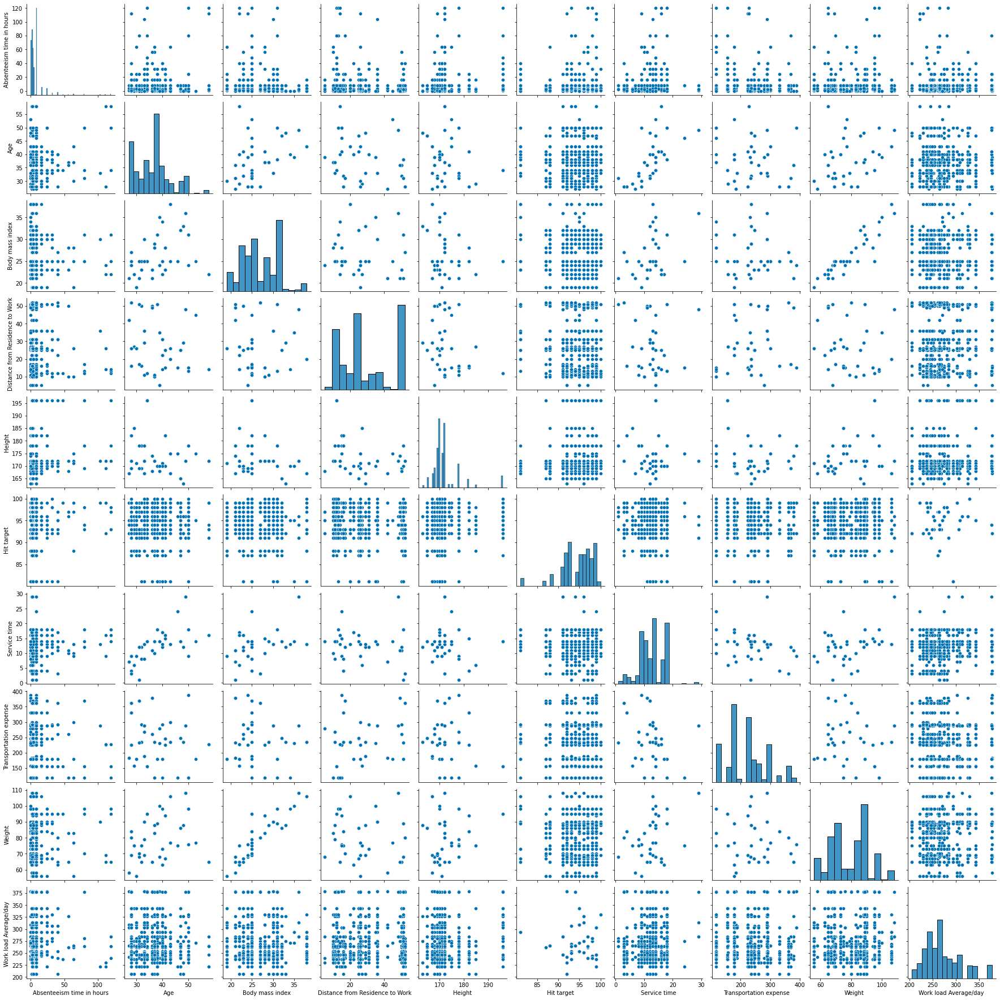

In [12]:
sns.pairplot(dataset_origin[num_vars])

In [13]:
dataset_origin.isnull().sum()

Reason for absence                 0
Month of absence                   0
Day of the week                    0
Seasons                            0
Transportation expense             0
Distance from Residence to Work    0
Service time                       0
Age                                0
Work load Average/day              0
Hit target                         0
Disciplinary failure               0
Education                          0
Son                                0
Social drinker                     0
Social smoker                      0
Pet                                0
Weight                             0
Height                             0
Body mass index                    0
Absenteeism time in hours          0
dtype: int64

Пропущенных значений нет - хорошо!

In [14]:
dataset_origin = dataset_origin[~dataset_origin.duplicated()]

In [15]:
dataset_origin.corr()

,Reason for absence,Month of absence,Day of the week,Seasons,Transportation expense,Distance from Residence to Work,Service time,Age,Work load Average/day,Hit target,Disciplinary failure,Education,Son,Social drinker,Social smoker,Pet,Weight,Height,Body mass index,Absenteeism time in hours
Reason for absence,1.000000,-0.060549,0.104978,-0.113816,-0.100801,0.149225,0.033600,-0.080563,-0.112523,0.083104,-0.545903,-0.049748,-0.022999,0.060977,-0.106660,-0.039273,-0.003361,-0.069254,0.029780,-0.162592
Month of absence,-0.060549,1.000000,0.007490,0.399176,0.110558,0.016847,-0.043352,0.003120,-0.182005,-0.464143,0.105467,-0.069248,0.051791,0.063071,-0.047275,0.022169,0.033404,-0.077826,0.067418,0.015598
Day of the week,0.104978,0.007490,1.000000,0.049079,0.045192,0.101956,0.015522,0.014685,0.030620,0.022289,-0.011344,0.043666,0.118616,0.043158,0.018293,-0.021476,-0.124129,-0.079219,-0.100332,-0.121380
Seasons,-0.113816,0.399176,0.049079,1.000000,0.028470,-0.053784,0.011764,-0.000531,0.151678,-0.057749,0.153163,-0.013584,0.037057,-0.033858,-0.050773,-0.001346,-0.019980,-0.035642,-0.002901,-0.008040
Transportation expense,-0.100801,0.110558,0.045192,0.028470,1.000000,0.278116,-0.353104,-0.233401,0.003768,-0.076073,0.105406,-0.054943,0.369243,0.140514,0.038218,0.388217,-0.210530,-0.204651,-0.133785,0.018275
Distance from Residence to Work,0.149225,0.016847,0.101956,-0.053784,0.278116,1.000000,0.097899,-0.155833,-0.046458,-0.039608,-0.052903,-0.260157,0.078245,0.436337,-0.071462,0.222901,-0.074094,-0.355345,0.089978,-0.084683
Service time,0.033600,-0.043352,0.015522,0.011764,-0.353104,0.097899,1.000000,0.673505,0.019649,-0.020210,0.003044,-0.201619,-0.031530,0.331185,0.078383,-0.437239,0.446540,-0.047838,0.489227,0.025472
Age,-0.080563,0.003120,0.014685,-0.000531,-0.233401,-0.155833,0.673505,1.000000,-0.036579,-0.037854,0.104483,-0.211326,0.057400,0.199947,0.122004,-0.228693,0.410335,-0.064922,0.465711,0.065822
Work load Average/day,-0.112523,-0.182005,0.030620,0.151678,0.003768,-0.046458,0.019649,-0.036579,1.000000,-0.082806,0.025729,-0.070154,0.014300,-0.016067,0.027067,-0.001839,-0.037382,0.099957,-0.088938,0.020150
Hit target,0.083104,-0.464143,0.022289,-0.057749,-0.076073,-0.039608,-0.020210,-0.037854,-0.082806,1.000000,-0.148169,0.112218,-0.005256,-0.115543,0.055240,0.008488,-0.055987,0.097441,-0.104477,0.029886


<AxesSubplot:>

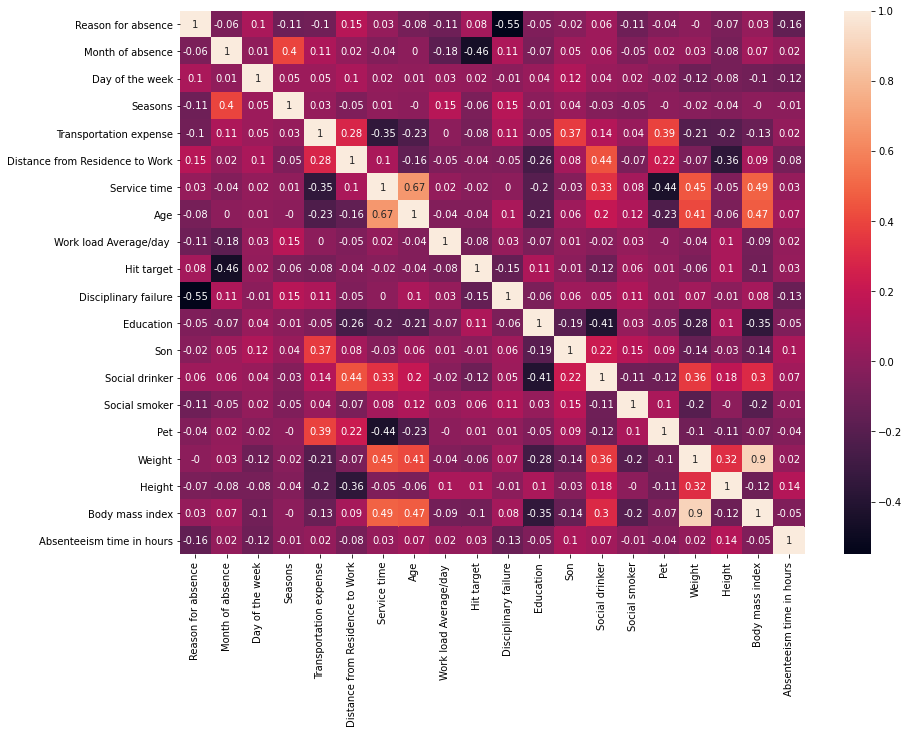

In [16]:
sns.heatmap(round(dataset_origin.corr(), 2), annot=True)

Как уже было отмечено ранее, сущестует высокая корреляция между индексом массы тела и весом. На данный момент я не буду это учитывать и оставлю так, как есть. Посмотрю как линейная модель справится с этим. 

<AxesSubplot:xlabel='Absenteeism time in hours', ylabel='Count'>

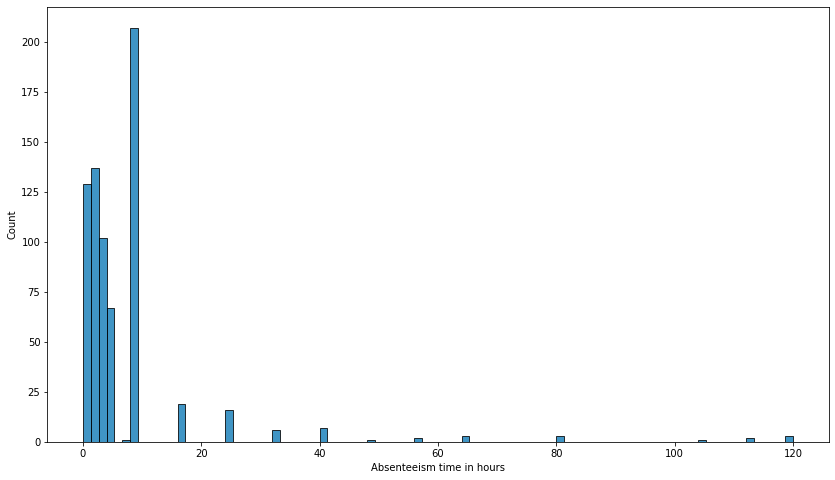

In [17]:
plt.figure(figsize=(14,8))
sns.histplot(dataset_origin['Absenteeism time in hours'])

<AxesSubplot:ylabel='Absenteeism time in hours'>

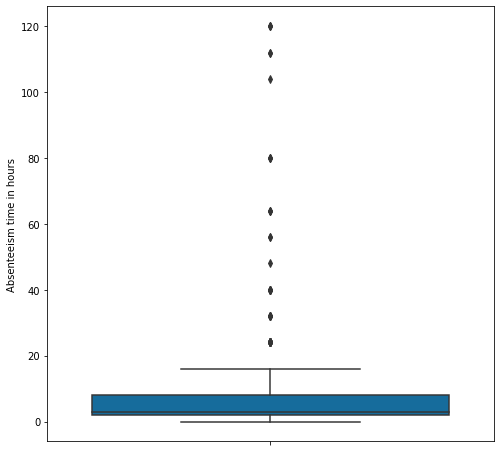

In [18]:
plt.figure(figsize=(8,8))
sns.boxplot(y=dataset_origin['Absenteeism time in hours'])

Целевая переменная выглядит не очень хорошо. Распределение что-то типа лог-нормального. 

In [19]:
dataset_origin['Absenteeism time in hours'].apply(np.log)

0      1.386294
1          -inf
2      0.693147
3      1.386294
4      0.693147
         ...   
735    2.079442
736    1.386294
737        -inf
738        -inf
739        -inf
Name: Absenteeism time in hours, Length: 706, dtype: float64

Чтобы не было минус-бесконечности прибавлю единицу.

In [20]:
(dataset_origin['Absenteeism time in hours']+1).apply(np.log)

0      1.609438
1      0.000000
2      1.098612
3      1.609438
4      1.098612
         ...   
735    2.197225
736    1.609438
737    0.000000
738    0.000000
739    0.000000
Name: Absenteeism time in hours, Length: 706, dtype: float64

<AxesSubplot:xlabel='Absenteeism time in hours', ylabel='Count'>

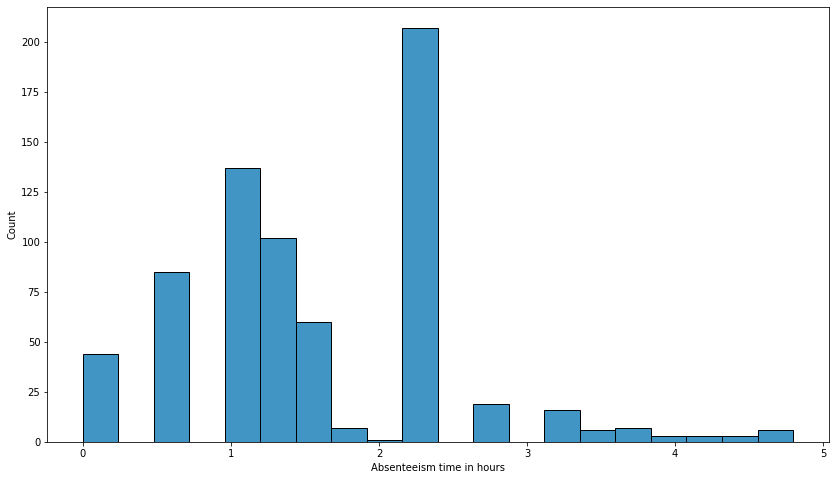

In [21]:
plt.figure(figsize=(14,8))
sns.histplot((dataset_origin['Absenteeism time in hours']+1).apply(np.log))

<AxesSubplot:ylabel='Absenteeism time in hours'>

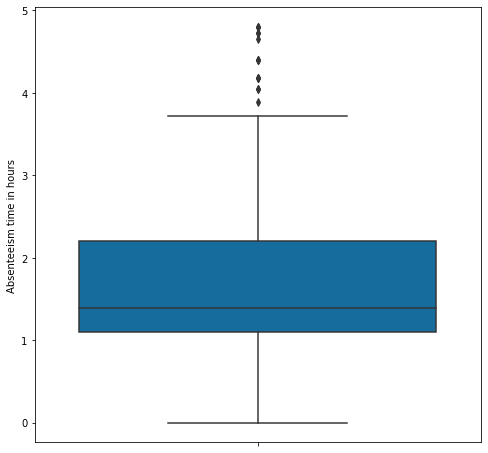

In [22]:
plt.figure(figsize=(8,8))
sns.boxplot(y=(dataset_origin['Absenteeism time in hours']+1).apply(np.log))

Ну, в целом, уже лучше.

Убираем выбросы целевой перменной.

In [23]:
dataset = dataset_origin.copy()

In [24]:
dataset = dataset[dataset['Absenteeism time in hours'] <= 60]

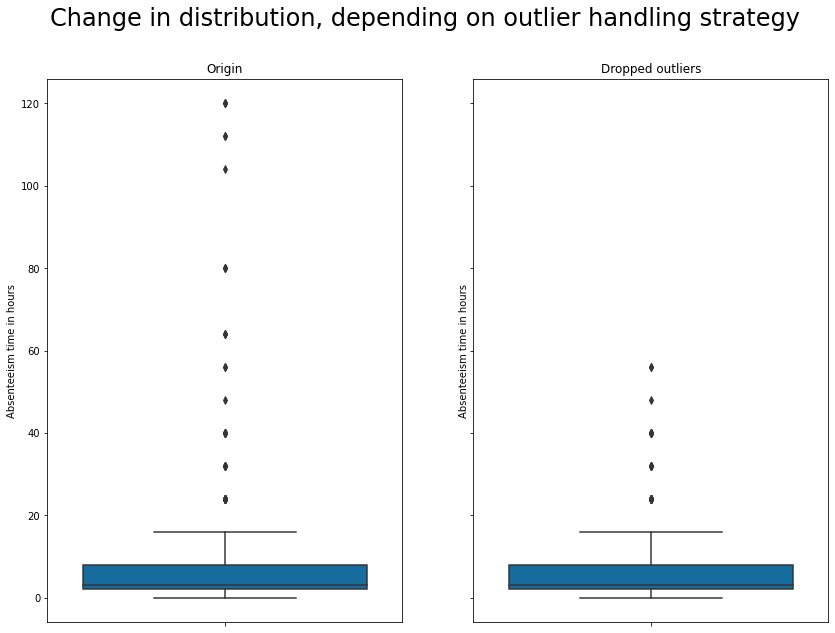

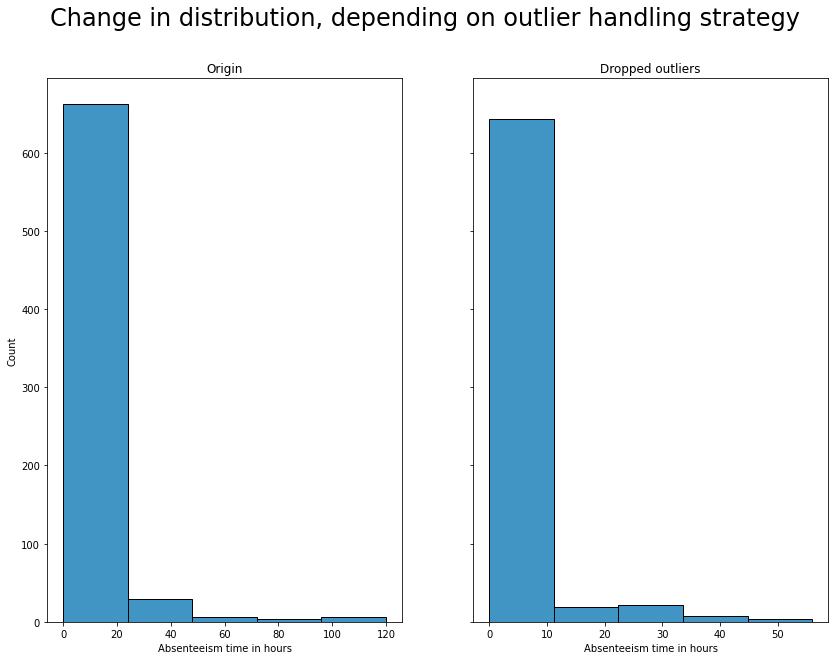

In [28]:
f, axes = plt.subplots(1, 2, sharey=True)
f.suptitle('Сhange in distribution, depending on outlier handling strategy', fontsize=24)
sns.boxplot(y=dataset_origin['Absenteeism time in hours'], ax=axes[0]).set_title("Origin")
sns.boxplot(y=dataset['Absenteeism time in hours'], ax=axes[1]).set_title("Dropped outliers");

f, axes = plt.subplots(1, 2, sharey=True)
f.suptitle('Сhange in distribution, depending on outlier handling strategy', fontsize=24)
sns.histplot(dataset_origin['Absenteeism time in hours'], bins=5, ax=axes[0]).set_title("Origin")
sns.histplot(dataset['Absenteeism time in hours'], bins=5, ax=axes[1]).set_title("Dropped outliers");

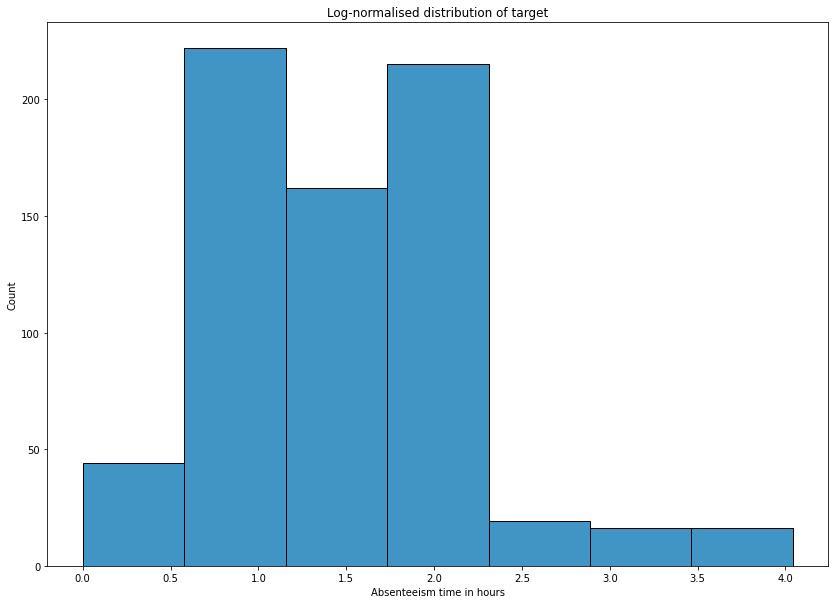

In [29]:
sns.histplot((dataset['Absenteeism time in hours']+1).apply(np.log), bins=7) \
    .set_title("Log-normalised distribution of target");

In [30]:
dataset['Absenteeism time in hours'] = (dataset['Absenteeism time in hours']+1).apply(np.log)

In [31]:
dataset.head()

,Reason for absence,Month of absence,Day of the week,Seasons,Transportation expense,Distance from Residence to Work,Service time,Age,Work load Average/day,Hit target,Disciplinary failure,Education,Son,Social drinker,Social smoker,Pet,Weight,Height,Body mass index,Absenteeism time in hours
0,26,7,3,1,289,36,13,33,239.554,97,0,1,2,1,0,1,90,172,30,1.609438
1,0,7,3,1,118,13,18,50,239.554,97,1,1,1,1,0,0,98,178,31,0.000000
2,23,7,4,1,179,51,18,38,239.554,97,0,1,0,1,0,0,89,170,31,1.098612
3,7,7,5,1,279,5,14,39,239.554,97,0,1,2,1,1,0,68,168,24,1.609438
4,23,7,5,1,289,36,13,33,239.554,97,0,1,2,1,0,1,90,172,30,1.098612


Work load Average/day - странные единицы измерения. Не минуты ли?

<AxesSubplot:>

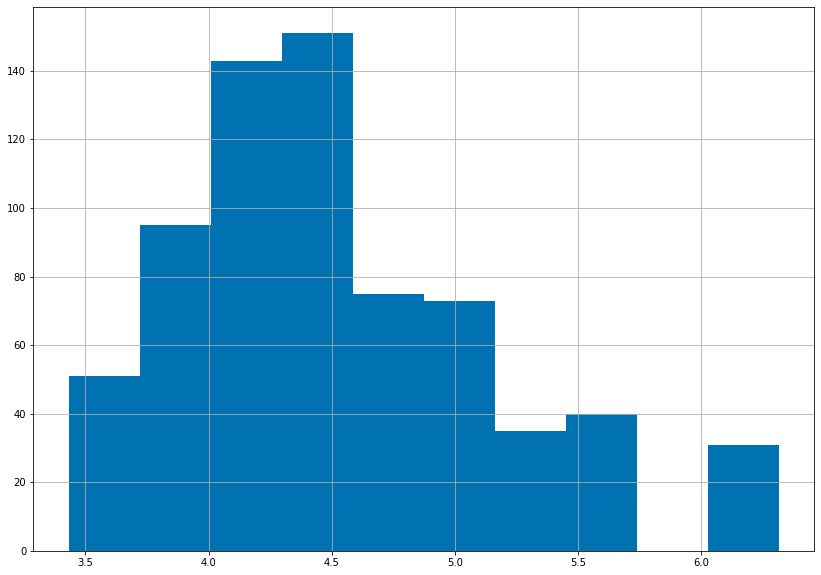

In [35]:
(dataset["Work load Average/day "]/60).hist()

Ага, точно, минуты. 

### Обработка категориальных переменных

In [39]:
cat_vars

['Reason for absence',
 'Month of absence',
 'Day of the week',
 'Seasons',
 'Disciplinary failure',
 'Education',
 'Son',
 'Social drinker',
 'Social smoker',
 'Pet']

In [41]:
dataset[cat_vars].head()

,Reason for absence,Month of absence,Day of the week,Seasons,Disciplinary failure,Education,Son,Social drinker,Social smoker,Pet
0,26,7,3,1,0,1,2,1,0,1
1,0,7,3,1,1,1,1,1,0,0
2,23,7,4,1,0,1,0,1,0,0
3,7,7,5,1,0,1,2,1,1,0
4,23,7,5,1,0,1,2,1,0,1


In [37]:
# pd.get_dummies(data = dataset, columns=cat_vars)

,Transportation expense,Distance from Residence to Work,Service time,Age,Work load Average/day,Hit target,Weight,Height,Body mass index,Absenteeism time in hours,...,Social drinker_0,Social drinker_1,Social smoker_0,Social smoker_1,Pet_0,Pet_1,Pet_2,Pet_4,Pet_5,Pet_8
0,289,36,13,33,239.554,97,90,172,30,1.609438,...,0,1,1,0,0,1,0,0,0,0
1,118,13,18,50,239.554,97,98,178,31,0.000000,...,0,1,1,0,1,0,0,0,0,0
2,179,51,18,38,239.554,97,89,170,31,1.098612,...,0,1,1,0,1,0,0,0,0,0
3,279,5,14,39,239.554,97,68,168,24,1.609438,...,0,1,0,1,1,0,0,0,0,0
4,289,36,13,33,239.554,97,90,172,30,1.098612,...,0,1,1,0,0,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
735,289,36,13,33,264.604,93,90,172,30,2.197225,...,0,1,1,0,0,1,0,0,0,0
736,235,11,14,37,264.604,93,88,172,29,1.609438,...,1,0,1,0,0,1,0,0,0,0
737,118,14,13,40,271.219,95,98,170,34,0.000000,...,0,1,1,0,0,0,0,0,0,1
738,231,35,14,39,271.219,95,100,170,35,0.000000,...,0,1,1,0,0,0,1,0,0,0


Результат - жесть. 81 столбец - это плохо и в этом нет особого смысла, скорее всего. Поэтому, надо делать умнее.

In [43]:
dataset['Reason for absence'].unique()

array([26,  0, 23,  7, 22, 19,  1, 11, 14, 21, 10, 13, 28, 18, 25, 24,  6,
       27, 17,  8, 12,  5,  9, 15,  4,  3,  2, 16])

<AxesSubplot:>

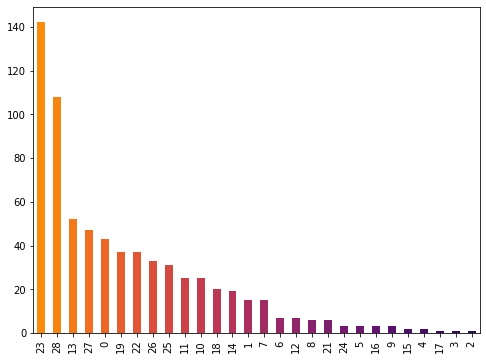

In [63]:
from matplotlib import cm

dataset['Reason for absence'].value_counts().plot(kind='bar', 
    stacked=True, color=cm.inferno_r(np.linspace(.25, .9, 30)), figsize=(8,6))

<AxesSubplot:>

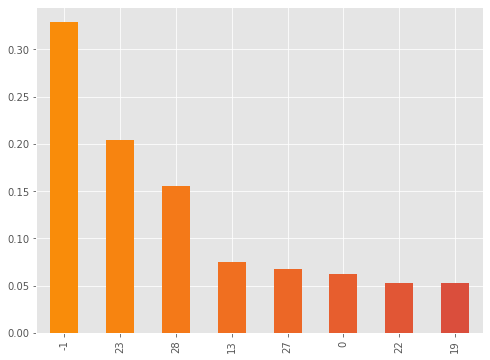

In [86]:
dataset['Reason for absence'].value_counts(normalize=True).plot(kind='bar', 
    stacked=True, color=cm.inferno_r(np.linspace(.25, .9, 30)), figsize=(8,6))

#### Frequency-encoding (частотное кодирование категориальных переменных)
Полезно, когда в категории очень много уникальных значений. 

In [76]:
dataset['Reason for absence'].value_counts(normalize=True).head(10)

-1     0.328530
 23    0.204611
 28    0.155620
 13    0.074928
 27    0.067723
 0     0.061960
 22    0.053314
 19    0.053314
Name: Reason for absence, dtype: float64

In [71]:
sum(dataset['Reason for absence'].value_counts(normalize=True).head(7))

0.6714697406340058

In [73]:
stay = [23, 28, 13, 27, 0, 19, 22]
dataset['Reason for absence'] = dataset['Reason for absence'].apply(lambda x: x if x in stay else -1)

<AxesSubplot:>

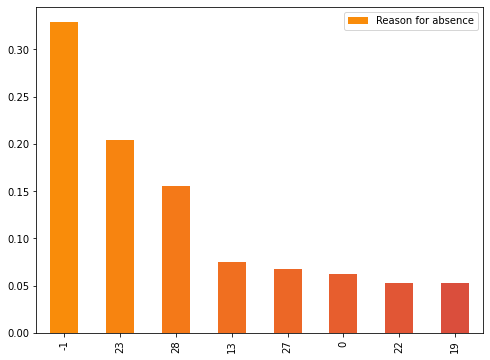

In [78]:
dataset['Reason for absence'].value_counts(normalize=True).plot(kind='bar', 
    stacked=True, color=cm.inferno_r(np.linspace(.25, .9, 30)), figsize=(8,6), legend=True)

<AxesSubplot:>

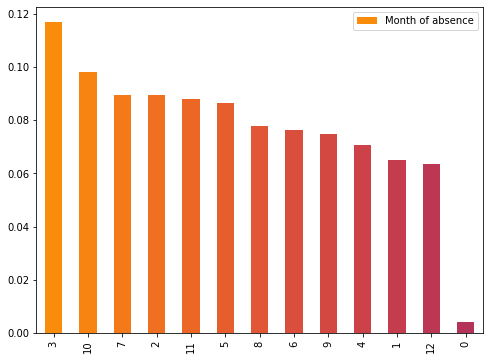

In [79]:
dataset["Month of absence"].value_counts(normalize=True).plot(kind='bar', 
    stacked=True, color=cm.inferno_r(np.linspace(.25, .9, 30)), figsize=(8,6), legend=True)

Нулевой месяц? Круто.

<AxesSubplot:>

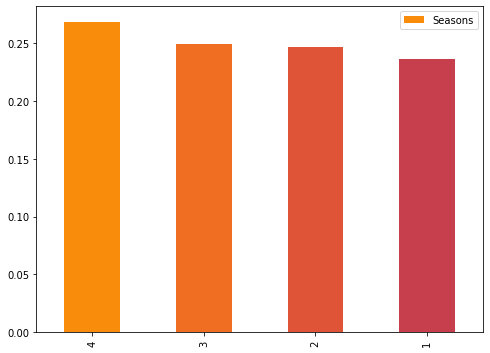

In [81]:
dataset["Seasons"].value_counts(normalize=True).plot(kind='bar', 
    stacked=True, color=cm.inferno_r(np.linspace(.25, .9, 10)), figsize=(8,6), legend=True)

Скоррелированы должны быть месяцы и сезоны. Дропну месяц, потому что может сезон важнее. Ну а вдруг?

In [82]:
dataset.drop(["Month of absence"], axis=1, inplace=True)

In [ ]:
# cat_vars.remove("Month of absence")

In [93]:
cat_vars_new = ['Reason for absence', 'Day of the week', 'Seasons', 'Disciplinary failure',
 'Education', 'Son', 'Social drinker', 'Social smoker', 'Pet']

In [94]:
dataset[cat_vars_new].head()

,Reason for absence,Day of the week,Seasons,Disciplinary failure,Education,Son,Social drinker,Social smoker,Pet
0,-1,3,1,0,1,2,1,0,1
1,0,3,1,1,1,1,1,0,0
2,23,4,1,0,1,0,1,0,0
3,-1,5,1,0,1,2,1,1,0
4,23,5,1,0,1,2,1,0,1


<AxesSubplot:>

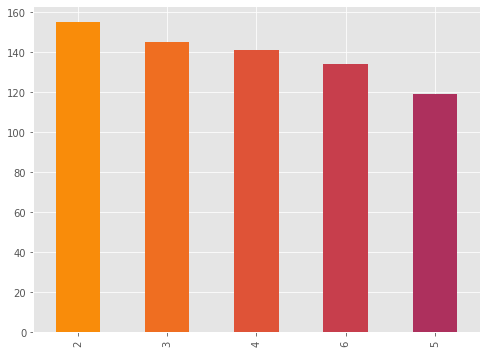

In [97]:
dataset['Day of the week'].value_counts().plot(kind='bar', 
    stacked=True, color=cm.inferno_r(np.linspace(.25, .9, 10)), figsize=(8,6))

In [99]:
dataset[cat_vars].head()

,Reason for absence,Day of the week,Seasons,Disciplinary failure,Education,Son,Social drinker,Social smoker,Pet
0,-1,3,1,0,1,2,1,0,1
1,0,3,1,1,1,1,1,0,0
2,23,4,1,0,1,0,1,0,0
3,-1,5,1,0,1,2,1,1,0
4,23,5,1,0,1,2,1,0,1


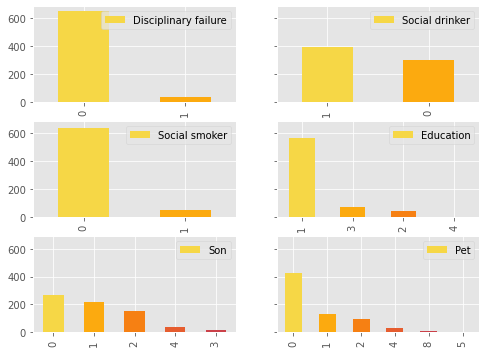

In [114]:
f, axes = plt.subplots(3, 2, sharey=True)

dataset['Disciplinary failure'].value_counts().plot(kind='bar', 
    stacked=True, color=cm.inferno_r(np.linspace(.1, .9, 10)), ax=axes[0,0],  figsize=(8,6), legend=True)
dataset['Social drinker'].value_counts().plot(kind='bar', 
    stacked=True, color=cm.inferno_r(np.linspace(.1, .9, 10)), ax=axes[0,1],  figsize=(8,6), legend=True)
dataset['Social smoker'].value_counts().plot(kind='bar', 
    stacked=True, color=cm.inferno_r(np.linspace(.1, .9, 10)), ax=axes[1,0],  figsize=(8,6), legend=True)
dataset['Education'].value_counts().plot(kind='bar', 
    stacked=True, color=cm.inferno_r(np.linspace(.1, .9, 10)), ax=axes[1,1],  figsize=(8,6), legend=True)
dataset['Son'].value_counts().plot(kind='bar', 
    stacked=True, color=cm.inferno_r(np.linspace(.1, .9, 10)), ax=axes[2,0],  figsize=(8,6), legend=True)
dataset['Pet'].value_counts().plot(kind='bar', 
    stacked=True, color=cm.inferno_r(np.linspace(.1, .9, 10)), ax=axes[2,1],  figsize=(8,6), legend=True);

In [117]:
dataset['Pet'] = dataset['Pet'].apply(lambda x: x if x in [0, 1] else "more")

### Обработка непрерывных переменных

In [ ]:
num_vars_wo_target = ['Age', 'Body mass index', 'Distance from Residence to Work',
       'Height', 'Hit target', 'Service time', 'Transportation expense', 'Weight', 'Work load Average/day ']

In [ ]:
dataset[num_vars_wo_target].head()

In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
X_train, y_yrain, X_test, y_test = train_test_split(dataset.drop(['Absenteeism time in hours'], axis=1), 
                                                    dataset['Absenteeism time in hours'], 
                                                    test_size=0.3)